# Unit 5 - Financial Planning
# Optional Challenge - Early Retirement

In [3]:

# Initial imports
import os
import requests
import json
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [4]:
# Load .env enviroment variables
load_dotenv()


True

### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [9]:
# Current amount of stocks and bonds 
spy_qty = 50
agg_qty = 200 

In [7]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("GGC_ALPACA_API_KEY")
alpaca_secret_key = os.getenv("GGC_ALPACA_SECRET_KEY")

# Create the Alpaca API object
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2"
)

In [8]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-08-07', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-08-07', tz='America/New_York').isoformat()

In [9]:

# Get 5 years' worth of historical data for SPY and AGG

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' 
timeframe = "1D"

# Get current closing prices for SPY and AGG
df_tickers = alpaca.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date
).df

# Preview DataFrame
df_tickers.head()

AGG                                        \
                             open      high      low   close     volume   
time                                                                      
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167.0   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778.0   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907.0   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979.0   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173.0   

                              SPY                                     
                             open    high     low   close     volume  
time                                                                  
2015-08-07 00:00:00-04:00  208.16  208.34  206.87  207.93   87669782  
2015-08-10 00:00:00-04:00  209.28  210.67  209.28  210.58   66755890  
2015-08-11 00:00:00-04:00  208.98  209.47  207.76  208.63   88424557  
2015-08-12 00:00:00-04:00  207.11  209.14  205.36  208.89  136171450  
2015-08-13 00:00:00-04:00  208.73  209.55  208.01  208.63   77197796


### Five Years Retirement Option

In [11]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# The objective is to reduce the # of years from 30 to 5 
# And increase profitability -> Higher initial investment + Higher risk weight  bonds vs stocks 

# Set number of simulations
num_sims = 500
num_years = 5

# Configure a Monte Carlo simulation to forecast 5 year daily returns 
MC_simulation = MCSimulation(
    portfolio_data = df_tickers,
    weights = [.40,.60],                            
    num_simulation = num_sims,
    num_trading_days = 252*num_years
)

In [12]:
# Print the simulation input data
MC_simulation.portfolio_data.head()

AGG                                        \
                             open      high      low   close     volume   
time                                                                      
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167.0   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778.0   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907.0   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979.0   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173.0   

                                           SPY                          \
                          daily_return    open    high     low   close   
time                                                                     
2015-08-07 00:00:00-04:00          NaN  208.16  208.34  206.87  207.93   
2015-08-10 00:00:00-04:00    -0.001374  209.28  210.67  209.28  210.58   
2015-08-11 00:00:00-04:00     0.003301  208.98  209.47  207.76  208.63   
2015-08-12 00:00:00-04:00    -0.000548  207.11  209.14  205.36  208.89   
2015-08-13 00:00:00-04:00    -0.001920  208.73  209.55  208.01  208.63   

                                                   
                              volume daily_return  
time                                               
2015-08-07 00:00:00-04:00   87669782          NaN  
2015-08-10 00:00:00-04:00   66755890     0.012745  
2015-08-11 00:00:00-04:00   88424557    -0.009260  
2015-08-12 00:00:00-04:00  136171450     0.001246  
2015-08-13 00:00:00-04:00   77197796    -0.001245

In [13]:
# Run Monte Carlo simulations to forecast cumulative daily returns
# sanity check 
#      num.of rows = 5y * 252d = 1260 
#      num of columns = 500 number of simulations (0..499)

MC_simulation.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.994822,1.000874,0.991935,0.994015,0.994929,0.998661,0.993301,0.999289,1.003977,1.005409,...,1.002533,0.999110,1.010398,0.991696,1.008245,1.002006,0.996337,0.995519,1.000012,0.993456
2,0.992938,1.005794,0.997119,0.995523,0.989616,0.998061,0.987647,1.002569,1.004620,1.008500,...,1.004163,0.999062,1.001772,0.992344,0.999663,1.007042,1.005376,1.001175,0.986270,0.989394
3,0.983763,1.000032,0.994933,0.998611,0.992666,1.002279,0.991255,0.996363,1.002639,1.007195,...,1.007940,1.006398,0.992267,0.985947,0.995675,1.002206,1.012446,1.001814,0.983405,0.986230
4,0.973601,1.003789,0.993374,1.001769,0.984249,1.025147,1.003343,1.002471,1.005288,1.009326,...,1.007368,1.009481,0.998379,0.983971,1.014219,0.994691,1.019214,1.013371,0.980544,0.984360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,0.938815,1.303737,1.478235,1.555794,1.414038,1.847392,0.873651,1.136425,2.457969,1.317374,...,0.967552,1.535304,1.800887,1.542641,1.045692,2.028084,1.855002,1.588668,0.989401,1.439955
1257,0.939007,1.297666,1.486652,1.563741,1.411657,1.837363,0.867945,1.133977,2.445382,1.317269,...,0.968267,1.530450,1.782307,1.556593,1.056288,2.014956,1.856867,1.598369,0.995280,1.449914
1258,0.937766,1.292101,1.492398,1.568313,1.417713,1.864623,0.863437,1.144407,2.441629,1.298644,...,0.971595,1.506615,1.774428,1.570594,1.054407,2.024002,1.855617,1.590961,1.002150,1.462056
1259,0.939085,1.291133,1.517416,1.585116,1.413129,1.833452,0.865631,1.142074,2.435051,1.304314,...,0.972164,1.488925,1.768090,1.557195,1.045667,2.033273,1.857328,1.608324,0.993995,1.444568


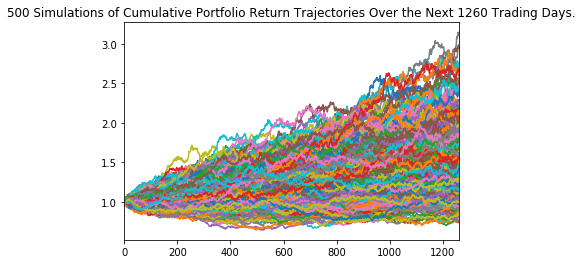

In [14]:
# Plot simulation outcomes
line_plot = MC_simulation.plot_simulation()

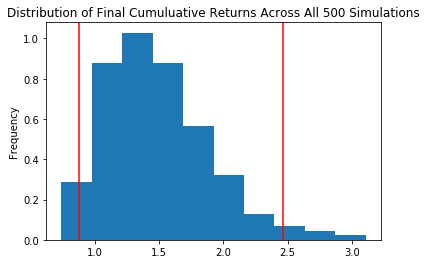

In [15]:
# Plot probability distribution and confidence intervals
dist_plot = MC_simulation.plot_distribution()

In [16]:
# Fetch summary statistics from the Monte Carlo simulation results
summary_stat = MC_simulation.summarize_cumulative_return()

# Print summary statistics
print(summary_stat)


count           500.000000
mean              1.485843
std               0.409186
min               0.736795
25%               1.178008
50%               1.428971
75%               1.726533
max               3.109138
95% CI Lower      0.877375
95% CI Upper      2.462859
Name: 1260, dtype: float64


In [17]:
# Set initial investment
initial_investment = 60000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60k
summary_stat_ci_lower = round(summary_stat[8]*initial_investment,2)
summary_stat_ci_upper = round(summary_stat[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next {num_years} years will end within in the range of"
      f" ${summary_stat_ci_lower} and ${summary_stat_ci_upper}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 5 years will end within in the range of $52642.51 and $147771.51


### Ten Years Retirement Option

In [18]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# The objective is to reduce the # of years from 30 to 10 
# And increase profitability -> Higher initial investment + Higher risk weight  .25 bonds vs .75 stocks 

# Set number of simulations
num_sims = 500
num_years = 10

# Configure a Monte Carlo simulation to forecast 5 year daily returns 
MC_simulation = MCSimulation(
    portfolio_data = df_tickers,
    weights = [.25,.75],                            
    num_simulation = num_sims,
    num_trading_days = 252*num_years 
)

In [19]:
# Print the simulation input data
MC_simulation.portfolio_data.head()

AGG                                        \
                             open      high      low   close     volume   
time                                                                      
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167.0   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778.0   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907.0   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979.0   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173.0   

                                           SPY                          \
                          daily_return    open    high     low   close   
time                                                                     
2015-08-07 00:00:00-04:00          NaN  208.16  208.34  206.87  207.93   
2015-08-10 00:00:00-04:00    -0.001374  209.28  210.67  209.28  210.58   
2015-08-11 00:00:00-04:00     0.003301  208.98  209.47  207.76  208.63   
2015-08-12 00:00:00-04:00    -0.000548  207.11  209.14  205.36  208.89   
2015-08-13 00:00:00-04:00    -0.001920  208.73  209.55  208.01  208.63   

                                                   
                              volume daily_return  
time                                               
2015-08-07 00:00:00-04:00   87669782          NaN  
2015-08-10 00:00:00-04:00   66755890     0.012745  
2015-08-11 00:00:00-04:00   88424557    -0.009260  
2015-08-12 00:00:00-04:00  136171450     0.001246  
2015-08-13 00:00:00-04:00   77197796    -0.001245

In [20]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative daily returns
# sanity check 
#      num.of rows = 10y * 252d = 2520 
#      num of columns = 500 number of simulations (0..499)

MC_simulation.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.991042,1.010472,1.006797,0.986714,0.988253,1.006154,0.992136,0.996289,1.005764,0.989727,...,1.012470,0.995222,1.015406,1.009517,1.008683,1.000077,0.995374,0.997057,1.007494,1.008804
2,0.991899,1.002388,1.002650,0.978443,0.990738,1.006523,0.992108,0.996239,1.002608,0.983826,...,1.024411,0.978140,1.014069,1.001451,1.010071,1.005186,0.998118,0.985360,1.001886,1.012739
3,1.003337,1.009011,1.011877,0.978745,0.981936,0.987837,0.979674,0.997805,1.004572,0.997348,...,1.040439,0.976924,1.007446,1.002706,0.996804,1.013249,0.978819,0.994530,1.013863,1.019916
4,1.001607,1.019167,1.027569,0.991730,0.997297,0.989654,0.995482,0.989419,1.002630,1.002163,...,1.025316,0.981224,0.997880,0.998463,1.000555,1.014860,0.980115,0.994277,1.016241,1.037047
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,1.570300,2.098834,0.965701,1.341196,1.587888,5.332961,1.976056,2.050470,2.939138,2.099377,...,2.124659,2.033686,0.990161,1.836680,1.591292,1.479505,0.801881,1.724188,4.989083,1.892354
2517,1.545218,2.105531,0.974798,1.350907,1.583136,5.330982,1.990549,2.036338,2.928033,2.109544,...,2.109272,2.048019,0.987335,1.805836,1.593004,1.458342,0.789505,1.707503,4.945540,1.894102
2518,1.557437,2.124940,0.972020,1.341376,1.613796,5.315949,1.996642,2.065975,2.944696,2.120583,...,2.112948,2.095871,0.971271,1.793285,1.579090,1.486125,0.788910,1.718811,4.938933,1.875697
2519,1.588419,2.115354,0.968656,1.323668,1.629653,5.314162,2.006937,2.084231,2.911036,2.127617,...,2.090892,2.084103,0.983375,1.775314,1.575851,1.470522,0.803781,1.714876,4.890508,1.884095


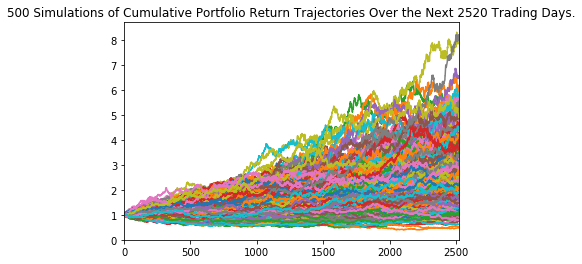

In [21]:
# Plot simulation outcomes
line_plot = MC_simulation.plot_simulation()

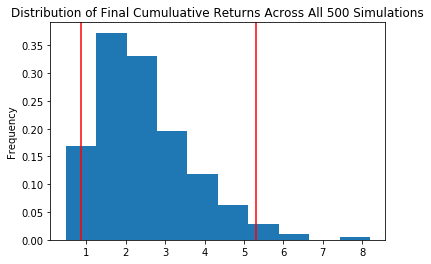

In [22]:
# Plot probability distribution and confidence intervals
dist_plot = MC_simulation.plot_distribution()

In [23]:
# Fetch summary statistics from the Monte Carlo simulation results
summary_stat = MC_simulation.summarize_cumulative_return()

# Print summary statistics
print(summary_stat)

count           500.000000
mean              2.486216
std               1.192128
min               0.475952
25%               1.674216
50%               2.218669
75%               3.086137
max               8.199451
95% CI Lower      0.874309
95% CI Upper      5.300914
Name: 2520, dtype: float64


In [24]:
# Set initial investment
initial_investment = 75000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60k
summary_stat_ci_lower = round(summary_stat[8]*initial_investment,2)
summary_stat_ci_upper = round(summary_stat[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio (weights -> bonds = {MC_simulation.weights[0]}, stocks = {MC_simulation.weights[1]}), "
      f" over the next {num_years} years will end within the range of"
      f" ${summary_stat_ci_lower} and ${summary_stat_ci_upper}")

if summary_stat_ci_lower < initial_investment:
    print(f"This is a riskier investment and it might end up in generating losses."
    f" Investment = ${initial_investment}, low-end = ${summary_stat_ci_lower}")

There is a 95% chance that an initial investment of $75000 in the portfolio (weights -> bonds = 0.25, stocks = 0.75),  over the next 10 years will end within the range of $65573.14 and $397568.58
This is a riskier investment and it might end up in generating losses. Investment = $75000, low-end = $65573.14
